In [1]:
from matplotlib import rcParams
import pandas as pd
import scanpy as sc
import anndata as ad
# add local forder to python lib ## why it's not working here but works in command line?
import importlib
# from sc_utils import scanpy_utils as su
import numpy as np
import os
import re
import matplotlib.pyplot as plt
import pickle
import seaborn as sns
from matplotlib.pyplot import rc_context
import numpy as np
import scipy.sparse as sp
import anndata
from typing import Dict, Optional
from collections import defaultdict
import itertools
import pygame
from matplotlib import cm
import matplotlib
import seaborn as sns
from collections import Counter
import decoupler as dc
from pypath.utils import go

custom_params = {"axes.spines.right": False, "axes.spines.top": False}
rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = ['Arial']
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.set_theme(style="ticks", rc=custom_params)

# matplotlib.rcParams['figure.figsize'] = [5, 5]
# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 3
sc.logging.print_header()
sc.set_figure_params(dpi=900, color_map='viridis_r')
%matplotlib inline

os.chdir('/mnt/data/hong/2022/human_placenta/')
adata = sc.read_h5ad('output/10x_h5/h5ad/ad_v2.h5ad')


pygame 2.1.3.dev8 (SDL 2.26.3, Python 3.10.8)
Hello from the pygame community. https://www.pygame.org/contribute.html


2024-08-20 07:13:23.945700: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


scanpy==1.9.6 anndata==0.8.0 umap==0.5.5 numpy==1.23.5 scipy==1.11.4 pandas==1.5.3 scikit-learn==1.4.0 statsmodels==0.14.0 igraph==0.10.3 pynndescent==0.5.8


In [2]:
import functools as ft


In [3]:
from sklearn import utils as sk_utils


In [3]:
# adata.X = ad_all.layers['log_norm'].copy()

msigdb = dc.get_resource('MSigDB', organism='human')

# Filter by hallmark
hallmark = msigdb[msigdb['collection'] == 'hallmark']

# Remove duplicated entries

hallmark = hallmark[~hallmark.duplicated(['geneset', 'genesymbol'])]


In [8]:
hallmark.describe()

,genesymbol,collection,geneset
count,7318,7318,7318
unique,4380,1,50
top,IL6,hallmark,HALLMARK_ESTROGEN_RESPONSE_LATE
freq,10,7318,200


In [4]:
def get_fc(comparison, celltype):
    data = pd.read_excel(f'output/DEGs/final_negbinom_all/{comparison}_group_sex_logngenes_w.xlsx', sheet_name=celltype, index_col=0)['avg_log2FC']
    data.index.name = 'names'
    data = data.to_frame()
    data.rename(columns={'avg_log2FC': comparison}, inplace=True)
    # print(data.head())
    return data


def gsea_table(stats, db, celltype, comparison):
    # mat = stats.T
    # m = csr_matrix(mat.values)
    # r = mat.index.values
    # c = mat.columns.values
    # print(c[:5])
    # msk = np.argsort(c)
    # print(mat[:,msk])
    scores, norm, pvals = dc.run_gsea(
        stats.T,
        db,
        source="geneset",
        target="genesymbol",
    )

    gsea_results = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )
    gsea_results.to_csv(
        f'output/gsea_hallmark/{celltype}_{comparison}.tsv', sep='\t')
    return gsea_results

# def plot_gsea(gsea_results):
#     sig = gsea_results.query('pval<0.05')


In [5]:
celltypes = ['CTB']
for celltype in celltypes:
    comparison = 'Normal_AGA_Obese_AGA'
    obese_aga_fc = get_fc(
        comparison, celltype)
    obese_aga_gsea = gsea_table(obese_aga_fc, hallmark, celltype, comparison)
    comparison = 'Normal_AGA_Obese_LAGA'
    obese_lga_fc = get_fc(
        comparison, celltype)
    obese_lga_gsea = gsea_table(obese_lga_fc, hallmark, celltype, comparison)
    # rbind gsea tables, add one column with source info (comparison)
    dfs = [obese_aga_gsea, obese_lga_gsea]
    df_all = ft.reduce(lambda left, right: pd.merge(
        left, right, how='inner', left_index=True, right_index=True), dfs)
    df_all.to_csv(f'output/gsea_hallmark/{celltype}.tsv', sep='\t')


In [7]:
celltypes = ['Fibroblast']
for celltype in celltypes:
    comparison = 'Normal_AGA_Obese_AGA'
    obese_aga_fc = get_fc(
        comparison, celltype)
    print(obese_aga_fc.head())
    obese_aga_gsea = gsea_table(obese_aga_fc, kegg_bp2use, celltype, comparison)
    comparison = 'Normal_AGA_Obese_LAGA'
    obese_lga_fc = get_fc(
        comparison, celltype)
    obese_lga_gsea = gsea_table(obese_lga_fc, kegg_bp2use, celltype, comparison)
    # rbind gsea tables, add one column with source info (comparison)
    dfs = [obese_aga_gsea, obese_lga_gsea]
    df_all = ft.reduce(lambda left, right: pd.merge(
        left, right, how='inner', left_index=True, right_index=True), dfs)
    df_all.to_csv(f'output/gsea_kegg/{celltype}.tsv', sep='\t')


        Normal_AGA_Obese_AGA
names                       
LRFN5              -2.184417
NEAT1               0.461392
MALAT1              0.016744
ARL17B              0.448906
MYOF                0.357474


NameError: name 'kegg_bp2use' is not defined

In [8]:
def _get_median(data):
    """Compute the median of data with n_zeros additional zeros.

    This function is used to support sparse matrices; it modifies data
    in-place.
    """
    n_elems = len(data)
    if not n_elems:
        return np.nan
    # n_negative = np.count_nonzero(data < 0)
    middle, is_odd = divmod(n_elems, 2)
    data.sort()

    if is_odd:
        return _get_elem_at_rank(middle, data)

    return (
        _get_elem_at_rank(middle - 1, data)
        + _get_elem_at_rank(middle, data)
    ) / 2.0


def _get_elem_at_rank(rank, data):
    """Find the value in data augmented with n_zeros for the given rank"""
    # if rank < n_negative:
    #     return data[rank]
    # if rank - n_negative < 0:
    #     return 0
    return data[rank]


def csc_median_axis_0(X):
    """Find the median across axis 0 of a CSC matrix.

    It is equivalent to doing np.median(X, axis=0).

    Parameters
    ----------
    X : sparse matrix of shape (n_samples, n_features)
        Input data. It should be of CSC format.

    Returns
    -------
    median : ndarray of shape (n_features,)
        Median.
    """
    if not sp.isspmatrix_csc(X):
        raise TypeError("Expected matrix of CSC format, got %s" % X.format)

    indptr = X.indptr
    n_samples, n_features = X.shape
    median = np.zeros(n_features)

    for f_ind, (start, end) in enumerate(zip(indptr[:-1], indptr[1:])):
        # Prevent modifying X in place
        data = np.copy(X.data[start:end])
        # nz = n_samples - data.size
        median[f_ind] = _get_median(data)

    return median


In [11]:
sct_hvg = ad_all[ad_all.obs['subset']=='STB', ad_all.var['highly_variable']].copy()
sct_hvg.layers['scale'] = sc.pp.scale(sct_hvg, layer='log_norm', copy=True)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [13]:
sct_hvg.X = sct_hvg.layers['scale'].X


In [19]:
# rank value encoding of single-cell transcriptomes
# make a layer of CPMedian
# ad_all.layers['CPMedian'] = ad_all.layers['raw'].copy()
# sc.pp.normalize_total(ad_all, layer='CPMedian')
ad_all.layers['rank'] = ad_all.layers['CPMedian'].copy()
# calculate non zeron median of each gene
# cpmedian_csr = ad_all.layers['CPMedian'].copy()
# cpmedian_csc = cpmedian_csr.tocsc(copy=True)
# # ad_all.var['non_zero_median'] = np.apply_along_axis(
# #     lambda v: np.median(v[v.nonzero()]), 0, cpmedian_csr)
ad_all.var['non_zero_median'] = csc_median_axis_0(cpmedian_csc)
# normalize each element in ad_all.layers['rank'].X by the non zero median of the gene
ad_all.layers['rank'] = ad_all.layers['rank'] / \
    ad_all.var['non_zero_median'].values


In [22]:
# sns.violinplot(ad_all.var['non_zero_median'].values)
sum(ad_all.var['non_zero_median'].values > 0)


26850

In [15]:
ad_all.X = ad_all.layers['rank'].copy()


In [14]:
dc.run_ora(
    mat=sct_hvg,
    net=go2use,
    source='geneset',
    target='genesymbol',
    verbose=True,
    use_raw=False
)


1 features of mat are empty, they will be removed.
Running ora on mat with 24580 samples and 1999 targets for 1 sources.


100%|██████████| 24580/24580 [00:09<00:00, 2533.68it/s]


In [17]:
# stb_acts = dc.get_acts(sct_hvg, obsm_key='ora_estimate')
# # stb = acts[acts.obs['subset'] == 'STB']
# # We need to remove inf and set them to the maximum value observed
# stb_v = stb_acts.X.ravel()
# max_e = np.nanmax(stb_v[np.isfinite(stb_v)])
# stb_acts.X[~np.isfinite(stb_acts.X)] = max_e.copy().item()

# # We can scale the obtained activities for better visualizations
# sc.pp.scale(stb_acts)
stb_acts


AnnData object with n_obs × n_vars = 24580 × 1
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'sample', 'group', 'batch', 'sex', 'mother', 'Hemoglobins', 'S_score', 'G2M_score', 'phase', 'leiden', 'cell type', 'subset'
    var: 'mean', 'std'
    uns: 'group_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'pearson_residuals_normalization', 'subset_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'latent_gene_encoding', 'ora_estimate', 'ora_pvals'

In [5]:
df = dc.rank_sources_groups(stb, groupby='group',
                            reference='rest', method='t-test_overestim_var')

n_markers = 3
source_markers = df.groupby('group').head(n_markers).groupby('group')[
    'names'].apply(lambda x: list(x)).to_dict()
stb.uns['top_pathways'] = source_markers


In [126]:
stb.obs = stb.obs[['sample', 'group']]


In [6]:
stb.uns.pop('pearson_residuals_normalization')
stb.obsm.pop('ora_estimate')
stb.obsm.pop('ora_pvals')
# sc.pp.scale(stb)


source,GOBP_10_FORMYLTETRAHYDROFOLATE_METABOLIC_PROCESS,GOBP_2FE_2S_CLUSTER_ASSEMBLY,GOBP_2_OXOGLUTARATE_METABOLIC_PROCESS,GOBP_3_PHOSPHOADENOSINE_5_PHOSPHOSULFATE_METABOLIC_PROCESS,GOBP_3_UTR_MEDIATED_MRNA_DESTABILIZATION,GOBP_3_UTR_MEDIATED_MRNA_STABILIZATION,GOBP_4FE_4S_CLUSTER_ASSEMBLY,GOBP_5S_CLASS_RRNA_TRANSCRIPTION_BY_RNA_POLYMERASE_III,GOBP_5_PHOSPHORIBOSE_1_DIPHOSPHATE_METABOLIC_PROCESS,GOBP_7_METHYLGUANOSINE_CAP_HYPERMETHYLATION,...,GOBP_XENOBIOTIC_TRANSPORT,GOBP_XENOBIOTIC_TRANSPORT_ACROSS_BLOOD_BRAIN_BARRIER,GOBP_XENOPHAGY,GOBP_XMP_METABOLIC_PROCESS,GOBP_XYLULOSE_5_PHOSPHATE_METABOLIC_PROCESS,GOBP_ZINC_ION_IMPORT_ACROSS_PLASMA_MEMBRANE,GOBP_ZINC_ION_IMPORT_INTO_ORGANELLE,GOBP_ZINC_ION_TRANSPORT,GOBP_ZYMOGEN_ACTIVATION,GOBP_ZYMOGEN_INHIBITION
TTCATTGTCACGAACT-1-placenta_81,1.0,0.501061,0.647619,1.000000,0.317859,0.048435,1.000000,1.000000,1.000000,1.000000,...,0.783204,1.000000,0.215804,1.0,1.000000,0.426609,1.000000,0.836093,0.552188,0.096287
TATCAGGCAGCTCATA-1-placenta_81,1.0,0.501061,0.266847,1.000000,0.317859,0.048435,1.000000,1.000000,1.000000,1.000000,...,0.783204,0.341058,0.052045,1.0,1.000000,0.426609,1.000000,0.836093,0.982360,0.096287
TTCCAATTCTCTGAGA-1-placenta_81,1.0,1.000000,1.000000,1.000000,0.101591,0.048435,1.000000,1.000000,1.000000,0.426609,...,0.783204,1.000000,0.052045,1.0,1.000000,1.000000,0.096287,0.528916,0.982360,0.096287
TCACATTGTCATGCAT-1-placenta_81,1.0,0.025373,1.000000,1.000000,0.101591,0.048435,0.039315,1.000000,1.000000,1.000000,...,0.542333,1.000000,0.215804,1.0,1.000000,0.426609,0.426609,0.528916,0.349743,0.096287
CAGGCCACAAAGTATG-1-placenta_81,1.0,1.000000,1.000000,1.000000,1.000000,0.048435,1.000000,1.000000,1.000000,1.000000,...,0.148691,0.341058,0.052045,1.0,1.000000,1.000000,1.000000,1.000000,0.982360,0.013100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACAACATCGGCGATC-1-placenta_314,1.0,0.501061,0.266847,1.000000,1.000000,0.767876,1.000000,0.341058,1.000000,1.000000,...,0.946204,1.000000,0.052045,1.0,0.293612,1.000000,1.000000,1.000000,0.756590,1.000000
AGCCAGCGTGCCCAGT-1-placenta_314,1.0,0.501061,0.266847,1.000000,1.000000,0.416608,1.000000,0.056383,0.293612,1.000000,...,0.783204,1.000000,0.052045,1.0,0.293612,1.000000,1.000000,1.000000,0.908487,0.426609
CCGGTGAGTGTTCGAT-1-placenta_314,1.0,0.501061,0.266847,1.000000,0.693389,0.767876,1.000000,0.056383,1.000000,1.000000,...,0.946204,1.000000,0.008863,1.0,0.293612,1.000000,1.000000,1.000000,0.908487,1.000000
AGGTCATAGCCTGACC-1-placenta_314,1.0,0.501061,0.266847,1.000000,1.000000,1.000000,1.000000,0.341058,1.000000,1.000000,...,0.946204,0.341058,0.052045,1.0,0.293612,1.000000,1.000000,1.000000,0.908487,1.000000


In [11]:
sc.pp.highly_variable_genes(stb, min_mean=1, min_disp=0.5, max_mean=50)
sc.pl.highly_variable_genes(stb)


extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [10]:
sc.pp.calculate_qc_metrics(stb, inplace=True)


In [68]:
stb_small = stb[:, stb.var['std'] > 0.3].copy()


AnnData object with n_obs × n_vars = 24580 × 7406
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'sample', 'group', 'batch', 'sex', 'mother', 'Hemoglobins', 'S_score', 'G2M_score', 'phase', 'leiden', 'cell type', 'subset', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'group_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'pearson_residuals_normalization', 'subset_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'latent_gene_encoding', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'

In [119]:
stb_small = stb[:, stb.var['pct_dropout_by_counts'] < 35]


<Axes: >

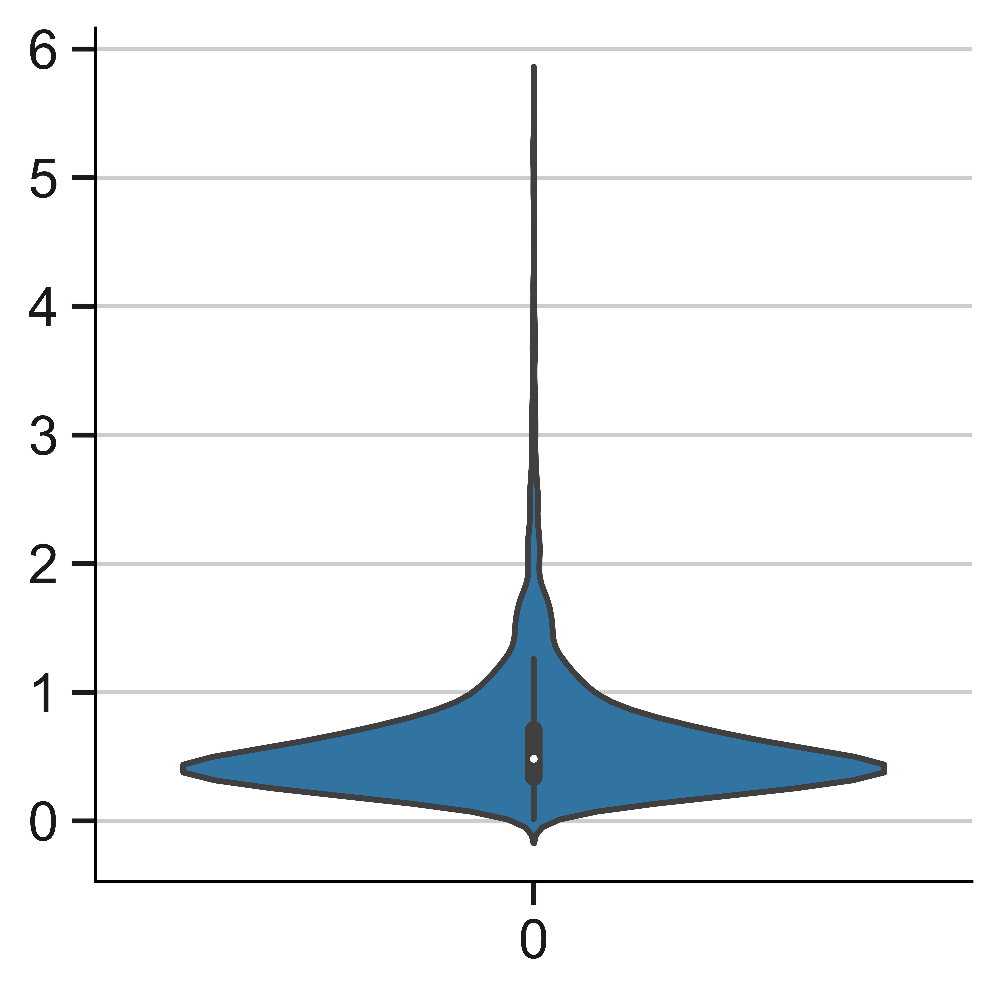

In [107]:
sns.violinplot(stb_small.var['std'],
               jitter=0.4, multi_panel=True)


In [55]:
stb.var.highly_variable.sum()


802

In [78]:
# sc.pp.scale(stb, max_value=10)
sc.tl.pca(stb, svd_solver='arpack', use_highly_variable=False)


computing PCA
    with n_comps=50
    finished (0:00:10)


In [79]:
sc.pl.pca(stb, color='group', components=['1,2', '3,4', '5,6', '7,8'], ncols=2)


/mnt/data/hong/anaconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/data/hong/anaconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/data/hong/anaconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/data/hong/anaconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


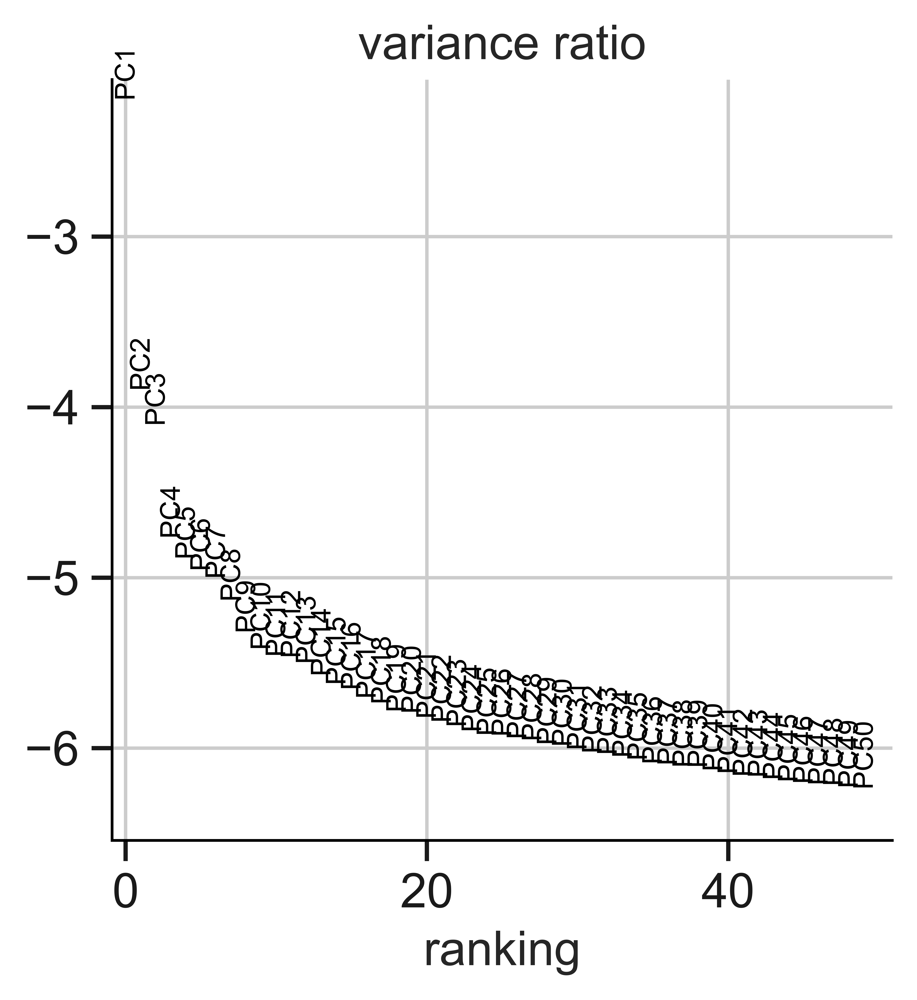

In [80]:
sc.pl.pca_variance_ratio(stb, log=True, n_pcs=50)


In [ ]:
sc.tl.tsne(adata, n_pcs=30)


In [12]:
# write out stb
stb.write_h5ad('output/10x_h5/h5ad/ad_decouple_stb.h5ad',
               compression='gzip')
